##구글 드라이브 임포트

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


----

## 폴더 생성

In [ ]:
import os

base_dir = '/content/drive/MyDrive/canAiry/ho_yolo_data_2'

#train, test, val 폴더 생성
train_dir = os.path.join(base_dir, 'train')
os.mkdir(train_dir)
test_dir = os.path.join(base_dir, 'test')
os.mkdir(test_dir)
validation_dir = os.path.join(base_dir, 'val')
os.mkdir(validation_dir)

In [ ]:
import os

base_dir = '/content/drive/MyDrive/canAiry/ho_yolo_data_2'

test_dir = os.path.join(base_dir, 'test')

labels_dir2 = os.path.join(test_dir, 'labels')
os.mkdir(labels_dir2)

In [ ]:
#train, test, val 폴더안에 이미지와 라벨 폴더 생성
images_dir = os.path.join(train_dir, 'images')
os.mkdir(images_dir)
labels_dir = os.path.join(train_dir, 'labels')
os.mkdir(labels_dir)

images_dir1 = os.path.join(validation_dir, 'images')
os.mkdir(images_dir1)
labels_dir1 = os.path.join(validation_dir, 'labels')
os.mkdir(labels_dir1)

images_dir2 = os.path.join(test_dir, 'images')
os.mkdir(images_dir2)
labels_dir2 = os.path.join(test_dir, 'labels')
os.mkdir(labels_dir2)

---

##첫번째 이미지 나누기

In [ ]:
from tqdm import tqdm

DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/03-1_IC-boiler/02_tlc"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
file_list_jpg

['0301010727(1443)(0001)0102.jpg',
 '0301010727(1443)(0011)0102.jpg',
 '0301010727(1443)(0016)0102.jpg',
 '0301010727(1443)(0021)0102.jpg',
 '0301010727(1443)(0026)0102.jpg',
 '0301010727(1443)(0031)0102.jpg',
 '0301010727(1443)(0036)0102.jpg',
 '0301010727(1443)(0046)0102.jpg',
 '0301010727(1443)(0051)0102.jpg',
 '0301010727(1443)(0056)0102.jpg',
 '0301010727(1443)(0061)0102.jpg',
 '0301010727(1443)(0066)0102.jpg',
 '0301010727(1443)(0076)0102.jpg',
 '0301010727(1443)(0081)0102.jpg',
 '0301010727(1443)(0086)0102.jpg',
 '0301010727(1443)(0091)0102.jpg',
 '0301010727(1443)(0096)0102.jpg',
 '0301010727(1443)(0101)0102.jpg',
 '0301010727(1443)(0111)0102.jpg',
 '0301010727(1443)(0116)0102.jpg',
 '0301010727(1443)(0121)0102.jpg',
 '0301010727(1443)(0126)0102.jpg',
 '0301010727(1443)(0131)0102.jpg',
 '0301010727(1443)(0141)0102.jpg',
 '0301010727(1443)(0146)0102.jpg',
 '0301010727(1443)(0151)0102.jpg',
 '0301010727(1443)(0156)0102.jpg',
 '0301010727(1443)(0161)0102.jpg',
 '0301010727(1443)(0

In [ ]:
len(file_list_jpg)

2600

###경량화 코드

In [ ]:
from tqdm import tqdm
import os
import glob
import shutil
def _copyfileobj_patched(fsrc, fdst, length=16*1024*1024):
    while 1:
        buf = fsrc.read(length)
        if not buf:
            break
        fdst.write(buf)


shutil.copyfileobj = _copyfileobj_patched 

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'

#전체 데이터중 80퍼의 사진을 train/lmages로 복사해서 옮김
for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 2600/2600 [00:59<00:00, 43.79it/s] 


In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list_tar = os.listdir(tar)
len(file_list_tar)

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1443)(", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

47

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

47

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1732)", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

65

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

65

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list = os.listdir(tar)
len(file_list)

2488

---

##첫번째 라벨 옮기기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/03-1_IC-boiler/01_label"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".json")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

2600

In [ ]:
from tqdm import tqdm
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 2600/2600 [01:16<00:00, 34.14it/s] 


In [ ]:
import glob
train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+"*.txt")
for i in train_list_file_json:
  os.remove(i)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

6085

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

2600

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1443)(", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

47

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'
file_list = os.listdir(tar)
len(file_list)

47

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1732)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

65

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

65

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

---

##라벨 타입 변경

현재 라벨 형식은 json 파일임

욜로 사용시 txt 형식이 들어가므로 json을 txt 형식으로 변경 해준다.

In [ ]:
import glob
import json

def coco_to_yolo(bbox, img_size):
    return [((2*bbox[0] + bbox[2])/(2*img_size[0])) , ((2*bbox[1] + bbox[3])/(2*img_size[1])), bbox[2]/img_size[0], bbox[3]/img_size[1]]

train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+"*.json")

for file_json in train_list_file_json:
  with open(file_json) as r:
    dict_json = json.load(r)
    for i, obj in enumerate(dict_json["annotations"]):
      if obj["attributes"]["status"] != 'normal':
        class_id = int(dict_json["metadata"]["facility_id"]) + 1
        bbox = list(dict_json["annotations"][i]["data"].values())
        img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]
      else:
        class_id = int(dict_json["metadata"]["facility_id"])
        bbox = list(dict_json["annotations"][i]["data"].values())
        img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]

      X, Y, W, H = coco_to_yolo(bbox, img_size)
      label = f"{class_id-1} {X} {Y} {W} {H}\n" 

      file_name = dict_json["image"]["filename"]
      file_name = file_name.replace(".jpg", "").strip()

      with open('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+file_name+".txt", "a") as w:
        w.write(label)

In [ ]:
for i in train_list_file_json:
  os.remove(i)

---

##두번째 이미지 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/03-2_IC-pump/02_tlc"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

3700

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 3700/3700 [01:12<00:00, 50.70it/s] 


In [ ]:
file_list = os.listdir(tar)
len(file_list)

6188

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0302030915(1105)", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

197

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'
file_list = os.listdir(tar)
len(file_list)

1129

In [ ]:
DIR_IN = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0302030915(1108)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

103

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1445)", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

43

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

949

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list = os.listdir(tar)
len(file_list)

6015

---

## 두번째 라벨 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/03-2_IC-pump/01_label"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".json")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

3597

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 3597/3597 [04:23<00:00, 13.63it/s] 


In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

6200

In [ ]:
def coco_to_yolo(bbox, img_size):
    return [((2*bbox[0] + bbox[2])/(2*img_size[0])) , ((2*bbox[1] + bbox[3])/(2*img_size[1])), bbox[2]/img_size[0], bbox[3]/img_size[1]]

train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+"*.json")

for file_json in train_list_file_json:
  with open(file_json) as r:
    dict_json = json.load(r)
    for i, obj in enumerate(dict_json["annotations"]):
      if obj["attributes"]["status"] != 'normal':
        class_id = int(dict_json["metadata"]["facility_id"]) + 2
        bbox = list(dict_json["annotations"][i]["data"].values())
        img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]
      else:
        class_id = int(dict_json["metadata"]["facility_id"]) + 1
        bbox = list(dict_json["annotations"][i]["data"].values())
        img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]

      X, Y, W, H = coco_to_yolo(bbox, img_size)
      label = f"{class_id-1} {X} {Y} {W} {H}\n" 

      file_name = dict_json["image"]["filename"]
      file_name = file_name.replace(".jpg", "").strip()

      with open('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+file_name+".txt", "a") as w:
        w.write(label)

In [ ]:
for i in train_list_file_json:
  os.remove(i)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

6085

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0302030915(1105)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

197

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'
file_list = os.listdir(tar)
len(file_list)

244

In [ ]:
train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels/'+"*.json")
for i in train_list_file_json:
  os.remove(i)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'
file_list = os.listdir(tar)
len(file_list)

150

---

##세번째 라벨 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0301010727(1445)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

43

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/labels'
file_list = os.listdir(tar)
len(file_list)

108

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

5845

---

## 세번째 라벨 나누기

In [ ]:
import os
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/04-1_TR-bearing/02_tlc"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

27500

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 27500/27500 [3:38:53<00:00,  2.09it/s]


In [ ]:
file_list = os.listdir(tar)
len(file_list)

33515

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0401011028(1301)L", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

400

In [ ]:
DIR_IN = '/content/drive/MyDrive/canAiry/ho_yolo_data/val/images'

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0401011028(1301)L", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

400

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

550

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0401011028(1301)R", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

386

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

521

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list = os.listdir(tar)
len(file_list)

32729

---

## 네번째 라벨 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/04-1_TR-bearing/01_label"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".json")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

27500

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 27500/27500 [4:52:34<00:00,  1.57it/s]


In [ ]:
file_list = os.listdir(tar)
len(file_list)

33515

In [ ]:
def coco_to_yolo(bbox, img_size):
    return [((2*bbox[0] + bbox[2])/(2*img_size[0])) , ((2*bbox[1] + bbox[3])/(2*img_size[1])), bbox[2]/img_size[0], bbox[3]/img_size[1]]

train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+"*.json")

for file_json in train_list_file_json:
  with open(file_json) as r:
    dict_json = json.load(r)
    for i, obj in enumerate(dict_json["annotations"]):
      class_id = int(dict_json["metadata"]["facility_id"])+2
      bbox = list(dict_json["annotations"][i]["data"].values())
      img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]
      
      X, Y, W, H = coco_to_yolo(bbox, img_size)
      label = f"{class_id-1} {X} {Y} {W} {H}\n" 

      file_name = dict_json["image"]["filename"]
      file_name = file_name.replace(".jpg", "").strip()

      with open('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+file_name+".txt", "a") as w:
        w.write(label)

In [ ]:
for i in train_list_file_json:
  os.remove(i)

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0401011028(1301)L", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

400

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

550

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0401011028(1301)R", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

386

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

521

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

32729

---

## 다섯번째 이미지 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/04-2_TR-gearbox/02_tlc"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

7100

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 7100/7100 [02:40<00:00, 44.19it/s] 


In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list = os.listdir(tar)
len(file_list)

39829

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0402011028(1248)", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

382

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

932

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0402011105(0919)", 0) and file.endswith(".jpg")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

385

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

906

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/images'
file_list = os.listdir(tar)
len(file_list)

39062

---

##다섯번째 라벨 나누기

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/data/01_1st-dataset/04-2_TR-gearbox/01_label"

file_list = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list if file.endswith(".json")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

7100

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'

for i in tqdm(file_list_jpg):
  src = os.path.join(DIR_IN, i)
  shutil.copy(src, tar)

100%|██████████| 7100/7100 [02:30<00:00, 47.03it/s] 


In [ ]:
file_list = os.listdir(tar)
len(file_list)

39829

In [ ]:
def coco_to_yolo(bbox, img_size):
    return [((2*bbox[0] + bbox[2])/(2*img_size[0])) , ((2*bbox[1] + bbox[3])/(2*img_size[1])), bbox[2]/img_size[0], bbox[3]/img_size[1]]

train_list_file_json = glob.glob('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+"*.json")

for file_json in train_list_file_json:
  with open(file_json) as r:
    dict_json = json.load(r)
    for i, obj in enumerate(dict_json["annotations"]):
      class_id = int(dict_json["metadata"]["facility_id"])+2
      bbox = list(dict_json["annotations"][i]["data"].values())
      img_size = [dict_json["metadata"]["width"], dict_json["metadata"]["height"]]
      
      X, Y, W, H = coco_to_yolo(bbox, img_size)
      label = f"{class_id-1} {X} {Y} {W} {H}\n" 

      file_name = dict_json["image"]["filename"]
      file_name = file_name.replace(".jpg", "").strip()

      with open('/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels/'+file_name+".txt", "a") as w:
        w.write(label)

In [ ]:
for i in train_list_file_json:
  os.remove(i)

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0402011028(1248)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

382

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/val/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

932

In [ ]:
DIR_IN = "/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels"

file_list1 = os.listdir(DIR_IN)
file_list_jpg = [file for file in file_list1 if file.startswith("0402011105(0919)", 0) and file.endswith(".txt")]
file_list_jpg.sort()

In [ ]:
len(file_list_jpg)

385

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/labels'

#옮김
for i in file_list_jpg:
  src = os.path.join(DIR_IN, i)
  shutil.move(src, tar)

In [ ]:
file_list = os.listdir(tar)
len(file_list)

906

In [ ]:
tar = '/content/drive/MyDrive/canAiry/ho_yolo_data_2/train/labels'
file_list = os.listdir(tar)
len(file_list)

39062

---

##Wandb 다운로드

In [ ]:
!pip install wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.8 MB 15.8 MB/s 
     |████████████████████████████████| 181 kB 87.3 MB/s 
     |████████████████████████████████| 158 kB 84.6 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
     |████████████████████████████████| 157 kB 101.3 MB/s 
     |████████████████████████████████| 157 kB 90.4 MB/s 
     |████████████████████████████████| 157 kB 102.1 MB/s 
     |████████████████████████████████| 157 kB 84.4 MB/s 
     |████████████████████████████████| 157 kB 98.5 MB/s 
     |████████████████████████████████| 157 kB 87.6 MB/s 
     |████████████████████████████████| 157 kB 96.2 MB/s 
     |████████████████████████████████| 156 kB 91.1 MB/s 
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=8e32f20b116ee160d9e4aa87209d9b7867a7ac636ba843ffc95fbbe8c49879ce
  Stored in directory: /root/.cache/pip/wheels/3e/

##YOLOV5 학습

In [ ]:
!python /content/drive/MyDrive/canAiry/data/yolov5/train.py --img 256 --batch 20 --epochs 300 --data /content/drive/MyDrive/canAiry/ho_yolo_data_2/data.yaml --weights /content/drive/MyDrive/canAiry/data/yolov5/runs/train/exp14/weights/best.pt --cache

train: weights=/content/drive/MyDrive/canAiry/data/yolov5/runs/train/exp14/weights/best.pt, cfg=, data=/content/drive/MyDrive/canAiry/ho_yolo_data_2/data.yaml, hyp=drive/MyDrive/canAiry/data/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=20, imgsz=256, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=drive/MyDrive/canAiry/data/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch origin' timed out after 5 seconds
requirements: ipython not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple

##결과 추론

In [ ]:
!python /content/drive/MyDrive/canAiry/data/yolov5/detect.py --weights /content/drive/MyDrive/canAiry/data/yolov5/runs/train/exp14/weights/best.pt --img 256 --conf 0.1 --source /content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images

detect: weights=['/content/drive/MyDrive/canAiry/data/yolov5/runs/train/exp14/weights/best.pt'], source=/content/drive/MyDrive/canAiry/ho_yolo_data_2/test/images, data=drive/MyDrive/canAiry/data/yolov5/data/coco128.yaml, imgsz=[256, 256], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=drive/MyDrive/canAiry/data/yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: ipython not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: 1 package updated per /content/drive/MyDrive/canAiry/data/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 v6.2-95

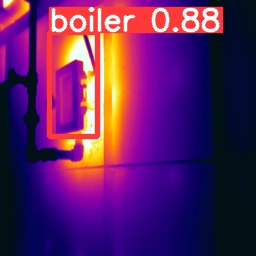

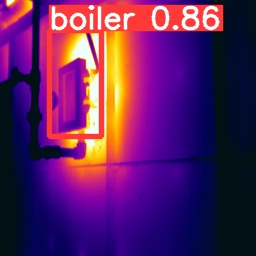

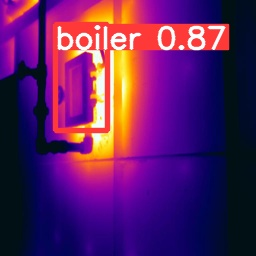

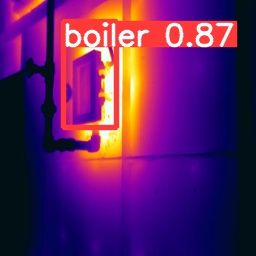

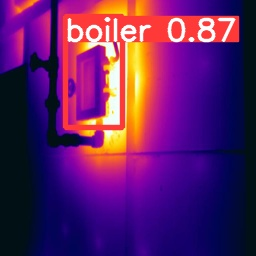

...

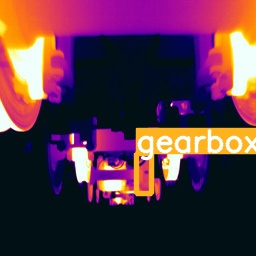

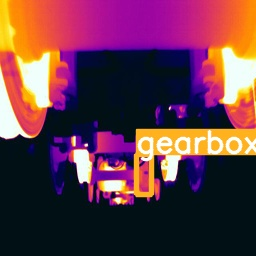

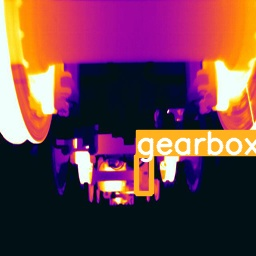

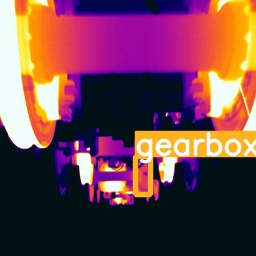

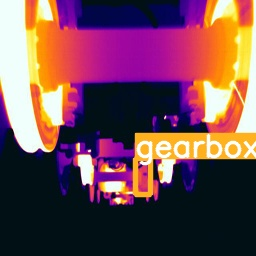

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/canAiry/data/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
import os
from PIL import Image
from IPython.display import Image as Img
from IPython.display import display

In [ ]:
def generate_gif(path):
    img_list = os.listdir(path)
    img_list = [path + '/' + x for x in img_list]
    images = [Image.open(x) for x in img_list]
    
    im = images[0]
    im.save('/content/drive/MyDrive/canAiry/data/out2.gif', save_all=True, append_images=images[1:],loop=0xff, duration=500)
    # loop 반복 횟수
    # duration 프레임 전환 속도 (500 = 0.5초)
    return Img(url='out2.gif')

In [ ]:
generate_gif('/content/drive/MyDrive/canAiry/data/yolov5/runs/detect/exp4')